#install dependencies

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip -q install webrtcvad

     |████████████████████████████████| 66 kB 2.5 MB/s 


In [ ]:
from scipy.io.wavfile import read
import os
import pandas as pd
import scipy
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm
import wave
import sys
import webrtcvad

In [ ]:
# !pip -q install wandb
# import wandb
# !wandb login

# Config

In [ ]:
root_path = '/content/drive/MyDrive/ปี4/tone-detection'
data_path = '/80-files'

In [ ]:
os.listdir(root_path+data_path)

FileNotFoundError: ignored

# load data

## test data

In [ ]:
root_path + os.listdir(root_path+data_path)[0]

FileNotFoundError: ignored

In [ ]:
sample_file = wave.open(root_path+data_path+'/'+os.listdir(root_path+data_path)[0],'r')
print(sample_file)
signal = sample_file.readframes(-1)
signal = np.fromstring(signal, "int16")
print(signal)

plt.figure(1)
plt.title("Signal Wave...")
plt.plot(signal)
plt.show()


FileNotFoundError: ignored

In [ ]:
samplerate, data = read(root_path+data_path+'/'+os.listdir(root_path+data_path)[0])
print(f"number of channels = {data.shape[1]}")
length = data.shape[0] / samplerate
print(f"length = {length}s")

time = np.linspace(0., length, data.shape[0])
plt.plot(time, data[:, 0], label="Left channel") # therapist
plt.plot(time, data[:, 1], label="Right channel") # patient
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.show()

In [ ]:
plt.plot(time, data[:, 1], label="Right channel") # patient
plt.legend()
# plt.xlabel("Time [s]")
# plt.ylabel("Amplitude")
plt.show()

In [ ]:
copy_data = data.copy()
copy_data[:, 0]=0

In [ ]:
from scipy.io.wavfile import write

write("example.wav", samplerate, copy_data.astype(np.int16))

In [ ]:
!pip install -q gtts
from gtts import gTTS
from IPython.display import Audio
from IPython.display import display

# sound_file = root_path+data_path+'/'+os.listdir(root_path+data_path)[0]
sound_file = 'example.wav'
wn = Audio(sound_file) ##
display(wn)##

## load real data

In [ ]:
data_list = os.listdir(root_path+data_path)
data = []
for i in tqdm(range(len(data_list))):
  samplerate, sound_data = read(root_path+data_path+'/'+data_list[i])
  # print(f"number of channels = {sound_data.shape[1]}")
  length = sound_data.shape[0] / samplerate
  print(f"length = {length}s")
  copy_data = sound_data.copy()
  copy_data[:, 0]=0
  data.append([data_list[i],length,samplerate,copy_data])


FileNotFoundError: ignored

In [ ]:
data[0][3]

NameError: ignored

In [ ]:
import librosa, librosa.display
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
signal, sr = librosa.load(librosa.util.example('brahms'))
print(signal,sr)
sr =22050*2

[-3.1496827e-05  4.5770057e-06  6.3310699e-06 ... -1.1488050e-05
 -7.4060167e-06 -8.0729487e-06] 22050


In [ ]:
signal.shape

(1010880,)

In [ ]:
signal[0]

-3.1496827e-05

In [ ]:
data[0][3][:,1]

array([-16, -22,  18, ...,  19,  15,  16], dtype=int16)

In [ ]:
# this is the number of samples in a window per fft
n_fft = 2048
# The amount of samples we are shifting after each fft
hop_length = 512
# Short-time Fourier Transformation on our audio data
audio_stft = librosa.core.stft(data[0][3][:,1], hop_length=hop_length, n_fft=n_fft)
# gathering the absolute values for all values in our audio_stft
spectrogram = np.abs(audio_stft)
# Converting the amplitude to decibels
log_spectro = librosa.amplitude_to_db(spectrogram)
# Plotting the short-time Fourier Transformation
plt.figure(figsize=(20, 5))
# Using librosa.display.specshow() to create our spectrogram
librosa.display.specshow(log_spectro, sr=sr, x_axis='time', y_axis='hz', hop_length=hop_length, cmap='magma')
plt.colorbar(label='Decibels')
plt.title('Spectrogram (dB)', fontdict=dict(size=18))
plt.xlabel('Time', fontdict=dict(size=15))
plt.ylabel('Frequency', fontdict=dict(size=15))
plt.show()


ParameterError: ignored

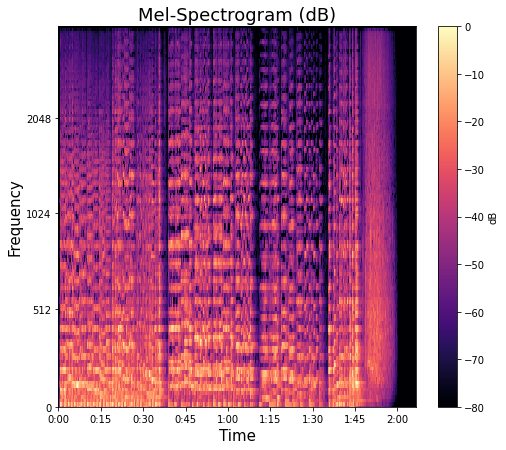

In [ ]:
 mel_signal = librosa.feature.melspectrogram(y=signal, sr=samplerate, hop_length=hop_length,
 n_fft=n_fft)
spectrogram = np.abs(mel_signal)
power_to_db = librosa.power_to_db(spectrogram, ref=np.max)
plt.figure(figsize=(8, 7))
librosa.display.specshow(power_to_db, sr=samplerate, x_axis='time', y_axis='mel', cmap='magma',
 hop_length=hop_length)
plt.colorbar(label='dB')
plt.title('Mel-Spectrogram (dB)', fontdict=dict(size=18))
plt.xlabel('Time', fontdict=dict(size=15))
plt.ylabel('Frequency', fontdict=dict(size=15))
plt.show()

In [ ]:
pd.read_csv('tone_211110_clean.csv')

,name,start,end,สะอื้น,ร้องไห้,พูดไม่มีแรง,เสียงเบา,เสียงสั่น,mono tone,ตอบช้า,ถามคำตอบคำ,เงียบบ่อย,tri_tone
0,q-6-4efb2443c06fe56b819a63ccc7094143-20200726-...,9,12,0,0,0,0,1,0,0,0,0,1
1,q-6-4efb2443c06fe56b819a63ccc7094143-20200726-...,19,20,0,0,0,0,1,0,0,0,0,1
2,q-6-4efb2443c06fe56b819a63ccc7094143-20200726-...,27,28,0,0,0,0,1,0,0,0,0,1
3,q-6-4efb2443c06fe56b819a63ccc7094143-20200726-...,32,34,0,0,0,0,1,0,0,0,0,1
4,q-6-4efb2443c06fe56b819a63ccc7094143-20200726-...,34,35,1,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
619,q-6-e0c124475d7e6c16edc74225bae5819f-20200629-...,1241,1450,1,0,0,0,0,0,0,0,0,1
620,q-6-e0c124475d7e6c16edc74225bae5819f-20200629-...,1800,1900,1,0,0,0,0,0,0,0,0,1
621,q-6-f3a803d1d465790e3c92aed571d7d8ea-20200725-...,76,85,0,0,0,0,1,0,0,0,0,1
622,q-6-f3a803d1d465790e3c92aed571d7d8ea-20200725-...,217,239,0,1,0,0,0,0,0,0,0,1


# DAIC-WOZ

In [ ]:
sample_file = wave.open(root_path+data_path+'/'+os.listdir(root_path+data_path)[0],'r')
sample_rate = 8000

FileNotFoundError: ignored

In [ ]:
signal = sample_file.readframes(-1)
signal = np.fromstring(signal, "int16")
signal

NameError: ignored

In [ ]:
len(signal)

18691840

In [ ]:
start = 0
end = 25e-3
startSample = int( start * sample_rate )
endSample = int( end * sample_rate )

signal[startSample:endSample]

array([  417,   -16,   494,   -22,   357,    18,   337,    -9,   149,
         -35,   101,    25,   150,    30,   122,   -29,   313,    -5,
         375,    18,   578,     6,   968,    -9,  1073,     2,  1225,
          22,  1506,    11,  1868,     9,  2158,    16,  2036,   -17,
        1831,   -26,  1575,   -13,  1009,   -11,   528,    -5,    70,
         -19,  -392,   -16,  -679,    14, -1077,   -11, -1327,   -34,
       -1472,     6, -1628,    13, -1511,   -12, -1296,    24, -1085,
          18,  -996,   -21, -1092,   -17, -1054,   -15, -1032,   -20,
       -1182,   -11, -1421,   -11, -1586,   -18, -1657,    -7, -1814,
          12, -1637,   -15, -1122,   -29,  -667,    13,  -311,    24,
          19,     7,   425,   -12,   743,   -14,  1048,   -12,  1393,
           0,  1612,    16,  1833,    20,  1828,    18,  1437,    10,
        1037,    21,   646,    24,   233,     7,  -140,    10,  -655,
          -7, -1200,   -24, -1656,   -13, -1921,     5, -1946,    31,
       -1991,     5,

In [ ]:
vad = webrtcvad.Vad()
vad.set_mode(1)

frame_duration = 10  # ms
# frame = b'\x00\x00' * int(sample_rate * frame_duration / 1000)
frame = signal[startSample:endSample]

print(vad.is_speech(frame, sample_rate))
# print 'Contains speech: %s' % (vad.is_speech(frame, sample_rate))

Error: ignored

In [ ]:
text = b''
for e in signal[startSample:endSample]:
  text = text + '\x' +bin(e)[2:]

SyntaxError: ignored

In [ ]:
import collections
import contextlib
import sys
import wave

import webrtcvad

In [ ]:
class Frame(object):
    """Represents a "frame" of audio data."""
    def __init__(self, bytes, timestamp, duration):
        self.bytes = bytes
        self.timestamp = timestamp
        self.duration = duration


In [ ]:
def frame_generator(frame_duration_ms, audio, sample_rate):
    """Generates audio frames from PCM audio data.
    Takes the desired frame duration in milliseconds, the PCM data, and
    the sample rate.
    Yields Frames of the requested duration.
    """
    n = int(sample_rate * (frame_duration_ms / 1000.0) * 2)
    offset = 0
    timestamp = 0.0
    duration = (float(n) / sample_rate) / 2.0
    while offset + n < len(audio):
        yield Frame(audio[offset:offset + n], timestamp, duration)
        timestamp += duration
        offset += n

In [ ]:
def read_wave(path):
    """Reads a .wav file.
    Takes the path, and returns (PCM audio data, sample rate).
    """
    with contextlib.closing(wave.open(path, 'rb')) as wf:
        sample_width=0
        sample_rate=0

        sample_rate = wf.getframerate()
        num_channels = wf.getnchannels()
        if num_channels == 1:
          sample_width = wf.getsampwidth()
        if sample_width == 2:
          sample_rate = wf.getframerate()
        if sample_rate in (8000, 16000, 32000, 48000):
          pcm_data = wf.readframes(wf.getnframes())
        return pcm_data, sample_rate


In [ ]:
audio, sample_rate = read_wave(root_path+data_path+'/'+os.listdir(root_path+data_path)[0])
sample_rate=8000
print(audio)
print(sample_rate)
vad = webrtcvad.Vad(int(1))
frames = frame_generator(30, audio, sample_rate)
frames = list(frames)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
frames[0].bytes

b"\xa1\x01\xf0\xff\xee\x01\xea\xffe\x01\x12\x00Q\x01\xf7\xff\x95\x00\xdd\xffe\x00\x19\x00\x96\x00\x1e\x00z\x00\xe3\xff9\x01\xfb\xffw\x01\x12\x00B\x02\x06\x00\xc8\x03\xf7\xff1\x04\x02\x00\xc9\x04\x16\x00\xe2\x05\x0b\x00L\x07\t\x00n\x08\x10\x00\xf4\x07\xef\xff'\x07\xe6\xff'\x06\xf3\xff\xf1\x03\xf5\xff\x10\x02\xfb\xffF\x00\xed\xffx\xfe\xf0\xffY\xfd\x0e\x00\xcb\xfb\xf5\xff\xd1\xfa\xde\xff@\xfa\x06\x00\xa4\xf9\r\x00\x19\xfa\xf4\xff\xf0\xfa\x18\x00\xc3\xfb\x12\x00\x1c\xfc\xeb\xff\xbc\xfb\xef\xff\xe2\xfb\xf1\xff\xf8\xfb\xec\xffb\xfb\xf5\xffs\xfa\xf5\xff\xce\xf9\xee\xff\x87\xf9\xf9\xff\xea\xf8\x0c\x00\x9b\xf9\xf1\xff\x9e\xfb\xe3\xffe\xfd\r\x00\xc9\xfe\x18\x00\x13\x00\x07\x00\xa9\x01\xf4\xff\xe7\x02\xf2\xff\x18\x04\xf4\xffq\x05\x00\x00L\x06\x10\x00)\x07\x14\x00$\x07\x12\x00\x9d\x05\n\x00\r\x04\x15\x00\x86\x02\x18\x00\xe9\x00\x07\x00t\xff\n\x00q\xfd\xf9\xffP\xfb\xe8\xff\x88\xf9\xf3\xff\x7f\xf8\x05\x00f\xf8\x1f\x009\xf8\x05\x00G\xf8\xf5\xff\xc6\xf8\x08\x00\xb0\xf9\xfb\xff\xcd\xfb\x04\x00V\xfd\x0e

In [ ]:
int_values = [x for x in frames[0].bytes]
int_values

[161,
 1,
 240,
 255,
 238,
 1,
 234,
 255,
 101,
 1,
 18,
 0,
 81,
 1,
 247,
 255,
 149,
 0,
 221,
 255,
 101,
 0,
 25,
 0,
 150,
 0,
 30,
 0,
 122,
 0,
 227,
 255,
 57,
 1,
 251,
 255,
 119,
 1,
 18,
 0,
 66,
 2,
 6,
 0,
 200,
 3,
 247,
 255,
 49,
 4,
 2,
 0,
 201,
 4,
 22,
 0,
 226,
 5,
 11,
 0,
 76,
 7,
 9,
 0,
 110,
 8,
 16,
 0,
 244,
 7,
 239,
 255,
 39,
 7,
 230,
 255,
 39,
 6,
 243,
 255,
 241,
 3,
 245,
 255,
 16,
 2,
 251,
 255,
 70,
 0,
 237,
 255,
 120,
 254,
 240,
 255,
 89,
 253,
 14,
 0,
 203,
 251,
 245,
 255,
 209,
 250,
 222,
 255,
 64,
 250,
 6,
 0,
 164,
 249,
 13,
 0,
 25,
 250,
 244,
 255,
 240,
 250,
 24,
 0,
 195,
 251,
 18,
 0,
 28,
 252,
 235,
 255,
 188,
 251,
 239,
 255,
 226,
 251,
 241,
 255,
 248,
 251,
 236,
 255,
 98,
 251,
 245,
 255,
 115,
 250,
 245,
 255,
 206,
 249,
 238,
 255,
 135,
 249,
 249,
 255,
 234,
 248,
 12,
 0,
 155,
 249,
 241,
 255,
 158,
 251,
 227,
 255,
 101,
 253,
 13,
 0,
 201,
 254,
 24,
 0,
 19,
 0,
 7,
 0,
 169,
 1,
 244,
 255,

In [ ]:
for i in range(1000):
  print(vad.is_speech(frames[i].bytes, sample_rate))

True
True
True
True
True
True
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
True
True
True
True
True
False
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
False
False
False
True
True
True
True
True
True
True
True
True
True
True
True
True
False
False
True
True
True
True
False
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
Tru

In [ ]:
!git clone https://github.com/tyiannak/pyAudioAnalysis.git

Cloning into 'pyAudioAnalysis'...
remote: Enumerating objects: 3005, done.
remote: Counting objects: 100% (471/471), done.
remote: Compressing objects: 100% (302/302), done.
remote: Total 3005 (delta 216), reused 401 (delta 168), pack-reused 2534
Receiving objects: 100% (3005/3005), 167.82 MiB | 22.63 MiB/s, done.
Resolving deltas: 100% (1777/1777), done.


In [ ]:
!pip install -r pyAudioAnalysis/requirements.txt


     |████████████████████████████████| 10.3 MB 11.6 MB/s 
     |████████████████████████████████| 81 kB 5.8 MB/s 
     |████████████████████████████████| 27.4 MB 2.1 MB/s 
     |████████████████████████████████| 15.3 MB 23.3 MB/s 
     |████████████████████████████████| 369 kB 43.9 MB/s 
     |████████████████████████████████| 245 kB 19.7 MB/s 
     |████████████████████████████████| 22.3 MB 88 kB/s 
     |████████████████████████████████| 71 kB 9.8 MB/s 
     |████████████████████████████████| 23.9 MB 1.4 MB/s 
     |████████████████████████████████| 9.9 MB 50.1 MB/s 
     |████████████████████████████████| 242 kB 56.1 MB/s 
  Created wheel for simplejson: filename=simplejson-3.16.0-cp37-cp37m-linux_x86_64.whl size=114889 sha256=54bb1bc9c3f70d64c04a711c1a7f40b2dfc56c7ea0d365ffe6b677742eff6477
  Stored in directory: /root/.cache/pip/wheels/00/6f/29/109ee3b85a9f9861d4294b05e4597363d5ad3c9dfaccc78787
Successfully built simplejson
  Attempting uninstall: numpy
    Found existing installa

In [ ]:
!pip install -e pyAudioAnalysis


Obtaining file:///content/pyAudioAnalysis
  Running setup.py develop for pyAudioAnalysis


In [ ]:
from pyAudioAnalysis import audioTrainTest as aT

aT.extract_features_and_train(["classifierData/music","classifierData/speech"], 1.0, 1.0, aT.shortTermWindow, aT.shortTermStep, "svm", "svmSMtemp", False)
# aT.file_classification("data/doremi.wav", "svmSMtemp","svm")

ImportError: ignored

In [ ]:
!pip install pyAudioAnalysis